# Climate Change  
       Using 1743-2013 Earth Surface Temperature Data:
       
    1- Exploratory Data Analysis
    2- Carbon Dioxide and AverageTemperature Relation
    3- Dynamic Map
    4- Predictions of the Average Temperature for Turkey with Linear Regression

    References:

 - (https://www.kaggle.com/code/amelinvladislav/map-of-temperatures-and-analysis-of-global-warming)
 - (https://www.kaggle.com/code/derevirn/data-analysis-on-climate-change/notebook)
 - (https://www.kaggle.com/code/amelinvladislav/map-of-temperatures-and-analysis-of-global-warming)   
 - https://github.com/dhaitz/mplcyberpunk
 - https://www.kaggle.com/code/mikolajhojda/predictions-of-the-average-temperature-rise

In [253]:
#Library and data importing
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import geopandas
import numpy as np
# Plotly
import plotly.offline as py
import plotly.express as px
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import time
import warnings
warnings.filterwarnings('ignore')

import colorlover as cl
from plotly.subplots import make_subplots 
#style
import mplcyberpunk
colors = [
    '#08F7FE',  # teal/cyan
    '#FE53BB',  # pink
    '#F5D300',  # yellow
    '#00ff41', # matrix green
]

#model 
from scipy.stats import pearsonr
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression



#  Basemap for map visualization
from mpl_toolkits.basemap import Basemap
from matplotlib import animation, rc
from IPython.display import HTML

import io
import base64


In [224]:
#Load Global Data 
data_global = pd.read_csv("GlobalTemperatures.csv")
data_global["dt"] = pd.to_datetime(data_global["dt"])
#data_global=data_global.dropna()

In [225]:
data_global.head()

,dt,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty
0,1750-01-01,3.034,3.574,NaN,NaN,NaN,NaN,NaN,NaN
1,1750-02-01,3.083,3.702,NaN,NaN,NaN,NaN,NaN,NaN
2,1750-03-01,5.626,3.076,NaN,NaN,NaN,NaN,NaN,NaN
3,1750-04-01,8.490,2.451,NaN,NaN,NaN,NaN,NaN,NaN
4,1750-05-01,11.573,2.072,NaN,NaN,NaN,NaN,NaN,NaN


In [195]:
data_global.describe()

,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty
count,3180.000000,3180.000000,1992.000000,1992.000000,1992.000000,1992.000000,1992.000000,1992.000000
mean,8.374731,0.938468,14.350601,0.479782,2.743595,0.431849,15.212566,0.128532
std,4.381310,1.096440,4.309579,0.583203,4.155835,0.445838,1.274093,0.073587
min,-2.080000,0.034000,5.900000,0.044000,-5.407000,0.045000,12.475000,0.042000
25%,4.312000,0.186750,10.212000,0.142000,-1.334500,0.155000,14.047000,0.063000
50%,8.610500,0.392000,14.760000,0.252000,2.949500,0.279000,15.251000,0.122000
75%,12.548250,1.419250,18.451500,0.539000,6.778750,0.458250,16.396250,0.151000
max,19.021000,7.880000,21.320000,4.373000,9.715000,3.498000,17.611000,0.457000


# EDA

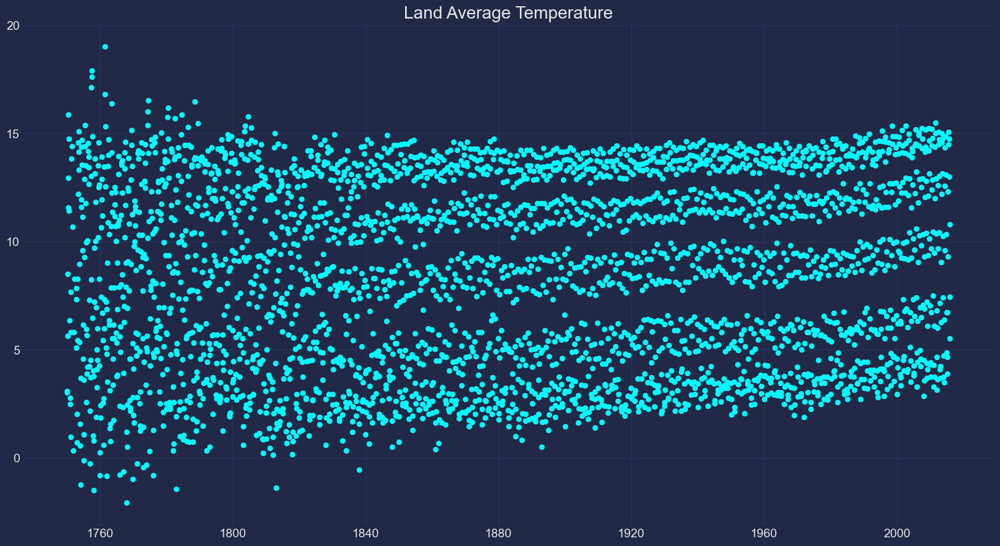

In [564]:
plt.figure(figsize=(18,10))
plt.scatter(data = data_global, x = 'dt',y = 'LandAverageTemperature')
plt.title("Land Average Temperature")
plt.style.use("cyberpunk")
plt.show()

In [159]:
#Annual means values for global data 
annual_mean_global = data_global.groupby(data_global["dt"].dt.year).mean()
reference_temperature_global = annual_mean_global.loc[1951:1980].mean()["LandAndOceanAverageTemperature"]
annual_mean_global["Anomaly"] = annual_mean_global["LandAndOceanAverageTemperature"] - reference_temperature_global

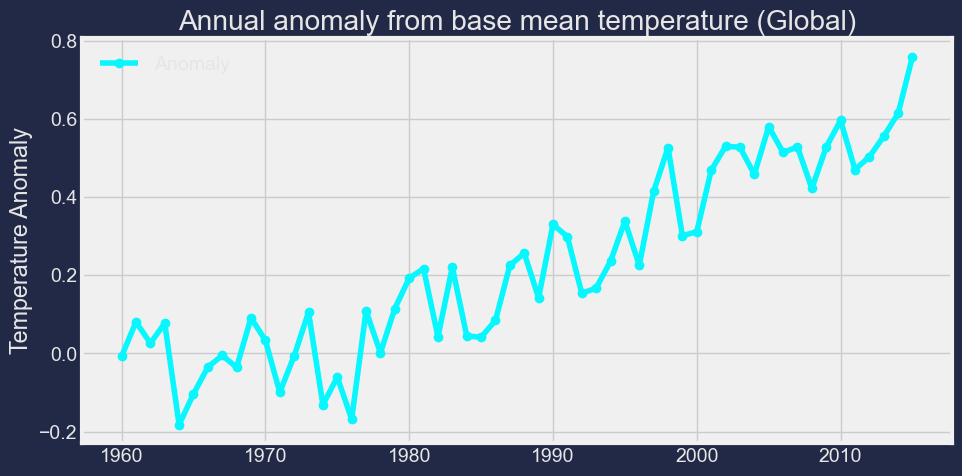

In [203]:
plt.figure()
plt.style.use("cyberpunk")
plt.style.use("fivethirtyeight")
annual_mean_global.loc[1960:2015]["Anomaly"].plot(figsize = (10,5), grid=True, legend=True, marker='o', color=colors[0])
plt.title("Annual anomaly from base mean temperature (Global)")
plt.xlabel('')
plt.ylabel('Temperature Anomaly')
plt.show()

In [161]:
#Load Country Data 
data_country = pd.read_csv("GlobalLandTemperaturesByCountry.csv")
#data_country=data_country.dropna()
data_turkey = data_country[data_country["Country"] == "Turkey"].copy()
data_turkey["dts"] = pd.to_datetime(data_turkey["dt"])
data_turkey['years'] = data_turkey['dt'].apply(lambda x: x[:4])

In [162]:
data_turkey.head()

,dt,AverageTemperature,AverageTemperatureUncertainty,Country,dts,years
533683,1777-02-01,3.000,3.314,Turkey,1777-02-01,1777
533684,1777-03-01,NaN,NaN,Turkey,1777-03-01,1777
533685,1777-04-01,7.678,2.553,Turkey,1777-04-01,1777
533686,1777-05-01,15.293,3.189,Turkey,1777-05-01,1777
533687,1777-06-01,18.661,2.993,Turkey,1777-06-01,1777


In [163]:
annual_mean_turkey = data_turkey.groupby(data_turkey["dts"].dt.year).mean()
reference_temperature_turkey = annual_mean_turkey.loc[1951:1980].mean()["AverageTemperature"]
annual_mean_turkey["Anomaly"] = annual_mean_turkey["AverageTemperature"] - reference_temperature_turkey

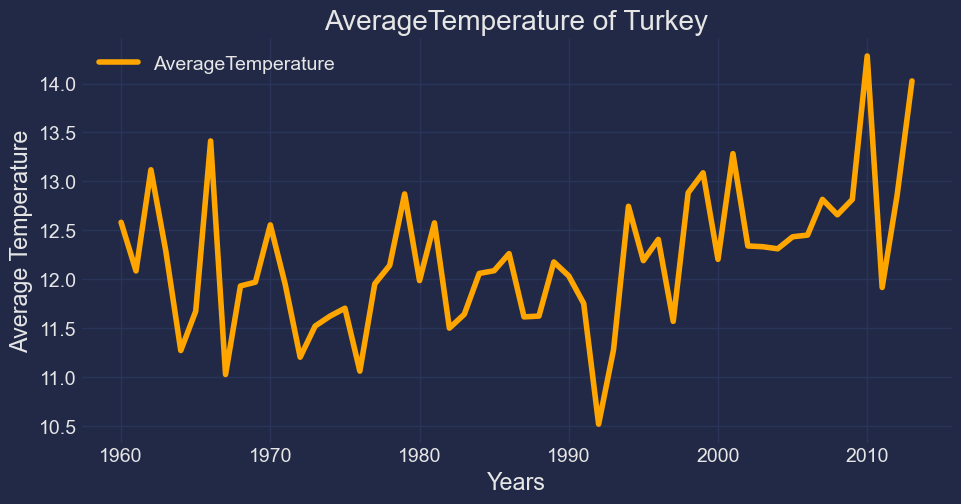

In [164]:
plt.figure()
plt.style.use("cyberpunk")
annual_mean_turkey.loc[1960:2013]["AverageTemperature"].plot(figsize = (10,5), grid=True, legend=True,color='orange')
plt.title("AverageTemperature of Turkey")
plt.xlabel('Years')
plt.ylabel('Average Temperature')
plt.show()

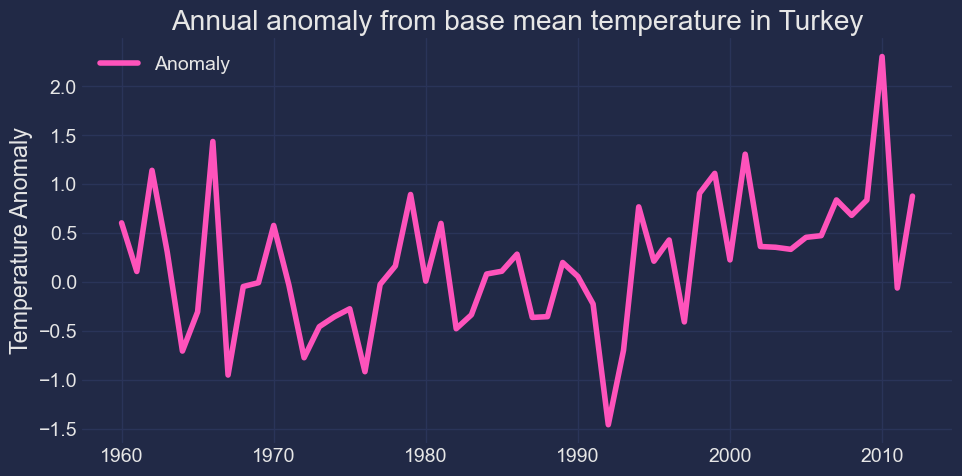

In [165]:
plt.figure()
plt.style.use("cyberpunk")
annual_mean_turkey.loc[1960:2012]["Anomaly"].plot(figsize = (10,5), grid=True, legend=True, color=colors[1])
plt.title("Annual anomaly from base mean temperature in Turkey")
plt.xlabel('')
plt.ylabel('Temperature Anomaly')
plt.show()

# Carbon Dioxide and AverageTemperature Relation

In [166]:
#Load global CO2 level data
co2_ppm = pd.read_csv("CarbonDioxideLevelsinAtmosphere.csv")
#co2_ppm = co2_ppm.dropna()

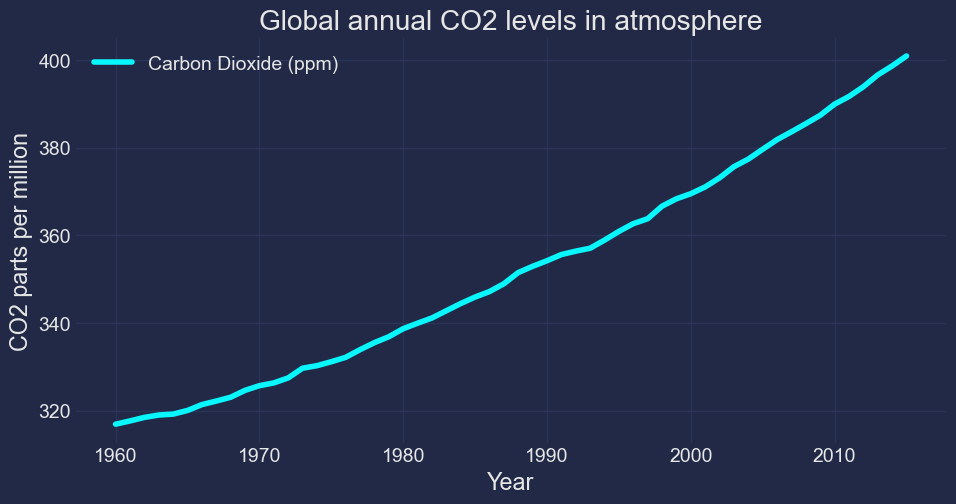

In [565]:
plt.figure()
annual_co2_ppm = co2_ppm.groupby(co2_ppm["Year"]).mean()
annual_co2_ppm.loc[1960:2015]["Carbon Dioxide (ppm)"].plot(figsize = (10,5), grid=True, legend=True)
plt.title("Global annual CO2 levels in atmosphere")
plt.ylabel("CO2 parts per million")
plt.style.use("cyberpunk")
plt.show()

It continues to increase.

In [168]:
annual_co2_temp = pd.merge(annual_mean_global.loc[1960:2015], annual_co2_ppm.loc[1960:2015], left_index=True, right_index=True)
annual_co2_temp = annual_co2_temp[["LandAndOceanAverageTemperature", "Anomaly", "Carbon Dioxide (ppm)"]].copy()
annual_co2_temp.corr() #CORRELATION 

,LandAndOceanAverageTemperature,Anomaly,Carbon Dioxide (ppm)
LandAndOceanAverageTemperature,1.000000,1.000000,0.923603
Anomaly,1.000000,1.000000,0.923603
Carbon Dioxide (ppm),0.923603,0.923603,1.000000


Carbon Dioxide (ppm)-LandAndOceanAverageTemperature

A positive correlation refers to the relationship between two variables moving in the same direction, one after the other.

CO2 levels in atmosphere is Increased every year.

Text(0, 0.5, 'Carbon Dioxide (ppm)')

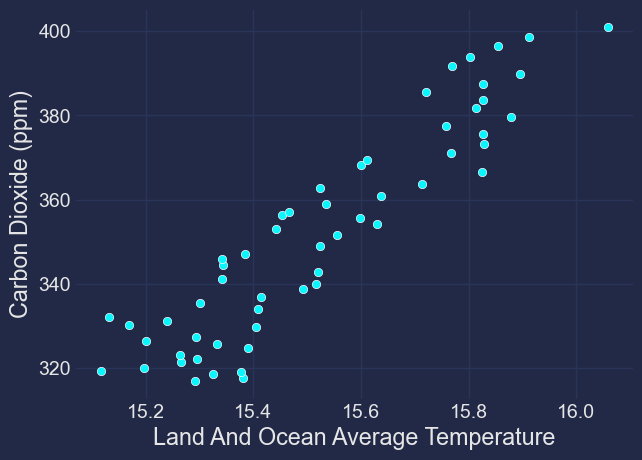

In [560]:
plt.plot(figsize = (10,5), grid=True, legend=True)
plt.style.use("cyberpunk")
plt.style.use("fivethirtyeight")
sns.scatterplot(x="LandAndOceanAverageTemperature",y="Carbon Dioxide (ppm)", data=annual_co2_temp)
plt.xlabel('Land And Ocean Average Temperature')
plt.ylabel('Carbon Dioxide (ppm)')

In [170]:
data_turkey

,dt,AverageTemperature,AverageTemperatureUncertainty,Country,dts,years
533683,1777-02-01,3.000,3.314,Turkey,1777-02-01,1777
533684,1777-03-01,NaN,NaN,Turkey,1777-03-01,1777
533685,1777-04-01,7.678,2.553,Turkey,1777-04-01,1777
533686,1777-05-01,15.293,3.189,Turkey,1777-05-01,1777
533687,1777-06-01,18.661,2.993,Turkey,1777-06-01,1777
...,...,...,...,...,...,...
536518,2013-05-01,17.522,0.360,Turkey,2013-05-01,2013
536519,2013-06-01,20.862,0.240,Turkey,2013-06-01,2013
536520,2013-07-01,23.335,0.281,Turkey,2013-07-01,2013
536521,2013-08-01,23.839,0.306,Turkey,2013-08-01,2013


In [171]:
turkey=data_turkey.groupby(['years'])['AverageTemperature'].mean().reset_index()
turkey.head()

,years,AverageTemperature
0,1777,12.688500
1,1778,11.931250
2,1779,12.031333
3,1780,12.248333
4,1781,11.669083


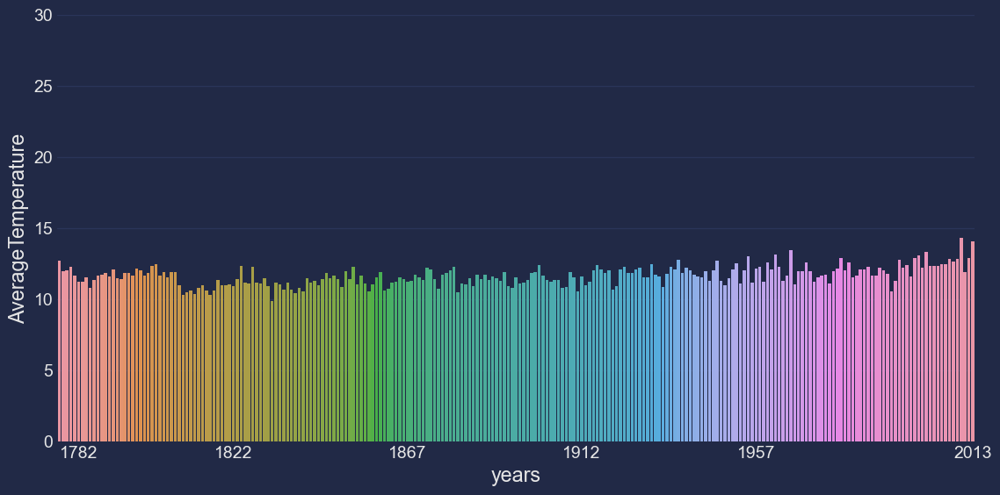

In [562]:
#Turkey Average Temperature Distribution
plt.figure(figsize=(12,6))
sns.barplot(data=turkey, x='years', y='AverageTemperature')
plt.xticks([5,45,90,135,180,236])
plt.ylim([0,30])
plt.style.use("cyberpunk")
plt.show()

# Dynamic Map

In [173]:
global_temp_country = pd.read_csv('GlobalLandTemperaturesByCountry.csv')
#global_temp_country =global_temp_country.dropna()

In [174]:
#Let's average temperature for each country

countries = np.unique(global_temp_country['Country'])
mean_temp = []
for country in countries:
    mean_temp.append(global_temp_country[global_temp_country['Country'] == 
                                               country]['AverageTemperature'].mean())

data = [ dict(
        type = 'choropleth',
        locations = countries,
        z = mean_temp,
        locationmode = 'country names',
        text = countries,
        marker = dict(
            line = dict(color = 'rgb(0,0,0)', width = 1)),
            colorbar = dict(autotick = True, tickprefix = '', 
            title = '# Average\nTemperature,\n°C')
            )
       ]
#--------------------- Fist Map with Orthographic Projection ---------------------------------------------------------------

layout = dict(
    title = 'Average land temperature in countries',
    geo = dict(
        showframe = False,
        showocean = True,
        oceancolor = 'rgb(0,255,255)',
        projection = dict(
        type = 'orthographic',
            rotation = dict(
                    lon = 60,
                    lat = 10),
        ),
        lonaxis =  dict(
                showgrid = True,
                gridcolor = 'rgb(102, 102, 102)'
            ),
        lataxis = dict(
                showgrid = True,
                gridcolor = 'rgb(102, 102, 102)'
                )
            ),
        )

fig = dict(data=data, layout=layout)
py.iplot(fig, validate=False, filename='worldmap')

#---------------------- Second Map with Equirectangular Projection --------------------------------------------------------------

layout2 = dict(
    title = 'Average land temperature in countries',
    geo = dict(
        showframe = False,
        showocean = True,
        oceancolor = 'rgb(0,255,255)',
        type = 'equirectangular'
    ),
)

fig2 = dict(data=data, layout2=layout2)
py.iplot(fig2, validate=False, filename='world_temp_map')


In [175]:
data_country["dts"] = pd.to_datetime(data_country["dt"])
data_country['years'] = data_country['dt'].apply(lambda x: x[:4])
by_year = data_country.groupby(by = ['years', 'Country', 'AverageTemperature', 'AverageTemperatureUncertainty','dts']).mean().reset_index()

In [176]:
data_country.head()

,dt,AverageTemperature,AverageTemperatureUncertainty,Country,dts,years
0,1743-11-01,4.384,2.294,Åland,1743-11-01,1743
1,1743-12-01,NaN,NaN,Åland,1743-12-01,1743
2,1744-01-01,NaN,NaN,Åland,1744-01-01,1744
3,1744-02-01,NaN,NaN,Åland,1744-02-01,1744
4,1744-03-01,NaN,NaN,Åland,1744-03-01,1744


In [177]:
# Append the continent & iso codes
continent_map = pd.read_csv("continents2.csv")
#continent_map =continent_map.dropna()
continent_map['Country'] = continent_map['name']
continent_map = continent_map[['Country', 'region', 'alpha-2', 'alpha-3']]

In [178]:
continent_map.head()

,Country,region,alpha-2,alpha-3
0,Afghanistan,Asia,AF,AFG
1,Åland Islands,Europe,AX,ALA
2,Albania,Europe,AL,ALB
3,Algeria,Africa,DZ,DZA
4,American Samoa,Oceania,AS,ASM


In [185]:
data_merge = pd.merge(left = data_country, right = continent_map, on = 'Country', how = 'left') 

In [189]:
df3=data_merge[["Country","region","years","dt","AverageTemperature","AverageTemperatureUncertainty"]].copy()

In [194]:
#d3=df2.dropna()
df4 = df3[df3['years'] > "1835"]

In [192]:
df4.tail()

,Country,region,years,dt,AverageTemperature,AverageTemperatureUncertainty
577457,Zimbabwe,Africa,2013,2013-05-01,19.059,1.022
577458,Zimbabwe,Africa,2013,2013-06-01,17.613,0.473
577459,Zimbabwe,Africa,2013,2013-07-01,17.000,0.453
577460,Zimbabwe,Africa,2013,2013-08-01,19.759,0.717
577461,Zimbabwe,Africa,2013,2013-09-01,NaN,NaN


In [193]:
fig = px.bar(df4, x="region", y="AverageTemperature", color="region",
  animation_frame="years", animation_group="region", range_y=[-5,40],title = 'Average Temperature Based on Regions for Each Year')
fig.show()

# Predictions of the Average Temperature for Turkey 
Linear Regression

In [391]:
df4.head()

,Country,region,years,dt,AverageTemperature,AverageTemperatureUncertainty
1106,Åland,NaN,1836,1836-01-01,-3.755,0.910
1107,Åland,NaN,1836,1836-02-01,-2.459,2.001
1108,Åland,NaN,1836,1836-03-01,1.162,1.408
1109,Åland,NaN,1836,1836-04-01,2.466,0.971
1110,Åland,NaN,1836,1836-05-01,4.895,1.794


In [469]:
tr=df4[df4["Country"] == "Turkey"].copy()

In [470]:
tr=tr.drop(["region","Country","dt"],axis=1)
tr

,years,AverageTemperature,AverageTemperatureUncertainty
534390,1836,-2.070,1.936
534391,1836,0.866,1.864
534392,1836,7.350,2.433
534393,1836,9.532,1.837
534394,1836,13.838,2.268
...,...,...,...
536518,2013,17.522,0.360
536519,2013,20.862,0.240
536520,2013,23.335,0.281
536521,2013,23.839,0.306


In [471]:
df_tr =tr.groupby('years')["AverageTemperature"].mean().reset_index()

In [542]:
df_tr

,years,AverageTemperature
0,1836,11.175667
1,1837,10.658083
2,1838,10.436500
3,1839,10.782083
4,1840,10.526667
...,...,...
173,2009,12.814833
174,2010,14.281667
175,2011,11.914500
176,2012,12.854417


In [543]:
from scipy.stats import pearsonr
corr, p = pearsonr(df_tr[df_tr['years'] >= 1835]['years'], df_tr[df_tr['years'] >= 1835]['AverageTemperature'])
print('Pearson correlation of Year and  Average Temperature: ' + str(corr))

Pearson correlation of Year and  Average Temperature: 0.5712634473896132


Positive Correlation

In [544]:
lr = LinearRegression()

In [545]:
X = df_tr['years']
y = df_tr['AverageTemperature']

X = X.values.reshape(-1,1)

In [546]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.8)

In [547]:
lr.fit(X_train, y_train)
lr.score(X_test, y_test)

0.08424801657418757

In [548]:
y_pred = lr.predict(X_test)

In [549]:
years = pd.DataFrame(X_test)

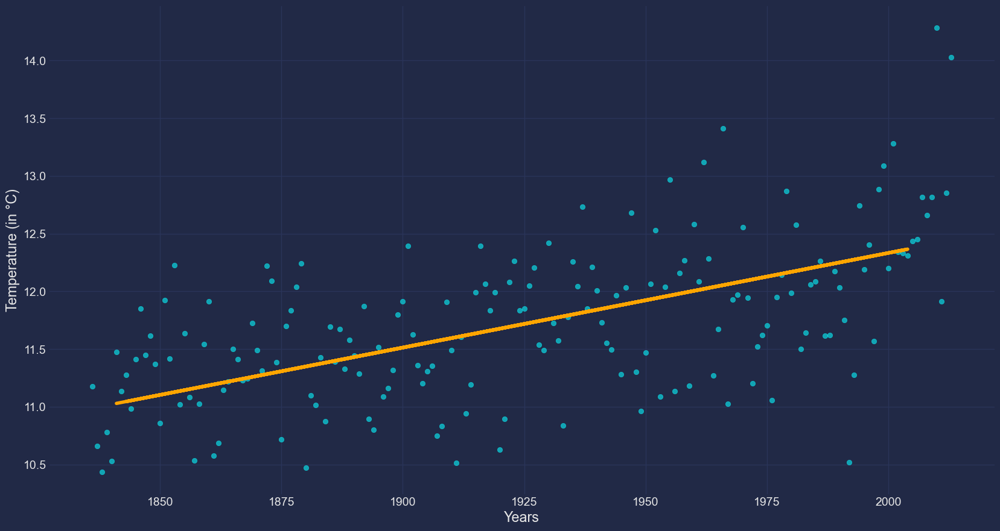

<Figure size 640x480 with 0 Axes>

In [550]:
plt.figure(figsize=(18,10))
plt.scatter(X, y, alpha=0.6)
plt.plot(X_test, y_pred, color="orange")
plt.style.use("cyberpunk")
plt.xlabel('Years')
plt.ylabel('Temperature (in °C)')
plt.show()
plt.clf()

In [551]:
print(lr.coef_)
print(10 * lr.coef_)

[0.00819676]
[0.08196763]


In [552]:
print(lr.predict(np.array([2030, 2050]).reshape(-1,1))) 

[12.57825246 12.74218772]


Interpretation

Every year, the average temperature increases by an average of 0.008 °C. Every ten years, the average temperature increases by an average of 0.0801 °C. The average temperature in 2030 will be 12.5453 °C and in 2050 12.7055 °C.